

## 1. Importing Necessary Libraries

Alicia comment: should we also write .. why we choose to do certain steps? and what it means etc? and a final summary?

In [65]:
import preprocessor as preprocessor
import svm as svm
import ytest as ytest
%matplotlib inline
import pandas as pd
import numpy as np
import pandas_profiling as pp
import matplotlib.pyplot as plt
from sklearn.ensemble import ExtraTreesClassifier
import seaborn as sns
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from lightgbm import LGBMClassifier
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import AdaBoostClassifier
from xgboost import XGBClassifier
from sklearn.ensemble import GradientBoostingClassifier
from catboost import CatBoostClassifier
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import train_test_split
import sklearn.metrics as metrics

## 2. Importing Dataset

In [66]:
data = pd.read_csv(r'dataset_of_diabetes.csv')
print("Data Shape - ", data.shape)
data.head(5)
# show the data of how many rows and columns

Data Shape -  (1000, 14)


,ID,No_Pation,Gender,AGE,Urea,Cr,HbA1c,Chol,TG,HDL,LDL,VLDL,BMI,CLASS
0,502,17975,F,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,N
1,735,34221,M,26,4.5,62,4.9,3.7,1.4,1.1,2.1,0.6,23.0,N
2,420,47975,F,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,N
3,680,87656,F,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,N
4,504,34223,M,33,7.1,46,4.9,4.9,1.0,0.8,2.0,0.4,21.0,N


## 3. Understanding the Data

In [67]:
# discription of the current data set
data.describe()

,ID,No_Pation,AGE,Urea,Cr,HbA1c,Chol,TG,HDL,LDL,VLDL,BMI
count,1000.000000,1.000000e+03,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,340.500000,2.705514e+05,53.528000,5.124743,68.943000,8.281160,4.862820,2.349610,1.204750,2.609790,1.854700,29.578020
std,240.397673,3.380758e+06,8.799241,2.935165,59.984747,2.534003,1.301738,1.401176,0.660414,1.115102,3.663599,4.962388
min,1.000000,1.230000e+02,20.000000,0.500000,6.000000,0.900000,0.000000,0.300000,0.200000,0.300000,0.100000,19.000000
25%,125.750000,2.406375e+04,51.000000,3.700000,48.000000,6.500000,4.000000,1.500000,0.900000,1.800000,0.700000,26.000000
50%,300.500000,3.439550e+04,55.000000,4.600000,60.000000,8.000000,4.800000,2.000000,1.100000,2.500000,0.900000,30.000000
75%,550.250000,4.538425e+04,59.000000,5.700000,73.000000,10.200000,5.600000,2.900000,1.300000,3.300000,1.500000,33.000000
max,800.000000,7.543566e+07,79.000000,38.900000,800.000000,16.000000,10.300000,13.800000,9.900000,9.900000,35.000000,47.750000


In [68]:
data.describe(include = np.object).transpose()

C:\Users\alici\AppData\Local\Temp\ipykernel_12172\466961875.py:1: DeprecationWarning: `np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  data.describe(include = np.object).transpose()


,count,unique,top,freq
Gender,1000,3,M,565
CLASS,1000,5,Y,840


In [69]:
data['Gender'].value_counts(normalize=True)

M    0.565
F    0.434
f    0.001
Name: Gender, dtype: float64

In [70]:
data.Gender.unique()

array(['F', 'M', 'f'], dtype=object)

In [71]:
data.tail()

,ID,No_Pation,Gender,AGE,Urea,Cr,HbA1c,Chol,TG,HDL,LDL,VLDL,BMI,CLASS
995,200,454317,M,71,11.0,97,7.0,7.5,1.7,1.2,1.8,0.6,30.0,Y
996,671,876534,M,31,3.0,60,12.3,4.1,2.2,0.7,2.4,15.4,37.2,Y
997,669,87654,M,30,7.1,81,6.7,4.1,1.1,1.2,2.4,8.1,27.4,Y
998,99,24004,M,38,5.8,59,6.7,5.3,2.0,1.6,2.9,14.0,40.5,Y
999,248,24054,M,54,5.0,67,6.9,3.8,1.7,1.1,3.0,0.7,33.0,Y


In [72]:
# check out if the data has all the data
data.isnull().values.any()

False

In [73]:
# to know the Dtype of the features
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 14 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   ID         1000 non-null   int64  
 1   No_Pation  1000 non-null   int64  
 2   Gender     1000 non-null   object 
 3   AGE        1000 non-null   int64  
 4   Urea       1000 non-null   float64
 5   Cr         1000 non-null   int64  
 6   HbA1c      1000 non-null   float64
 7   Chol       1000 non-null   float64
 8   TG         1000 non-null   float64
 9   HDL        1000 non-null   float64
 10  LDL        1000 non-null   float64
 11  VLDL       1000 non-null   float64
 12  BMI        1000 non-null   float64
 13  CLASS      1000 non-null   object 
dtypes: float64(8), int64(4), object(2)
memory usage: 109.5+ KB


In [74]:
data['CLASS'].value_counts(normalize=True)

Y     0.840
N     0.102
P     0.053
Y     0.004
N     0.001
Name: CLASS, dtype: float64

In [75]:
data['Gender'] = data.apply(lambda row: 0 if row['Gender'] == 'M' else 1, axis=1)

In [76]:
data['Gender'].value_counts(normalize=True)


0    0.565
1    0.435
Name: Gender, dtype: float64

In [77]:
data.CLASS.unique()

array(['N', 'N ', 'P', 'Y', 'Y '], dtype=object)

In [78]:
data['Gender'].value_counts(normalize=True)


0    0.565
1    0.435
Name: Gender, dtype: float64

In [79]:
data.CLASS.unique()

array(['N', 'N ', 'P', 'Y', 'Y '], dtype=object)

In [80]:
# fix space in the data in CLASS column
def fix_class(row):
    if row['CLASS'] == 'N':
        return 0
    elif row['CLASS'] == 'P':
        return 1
    elif row['CLASS'] == 'Y':
        return 2
    elif row['CLASS'] == 'N ':
        return 0
    elif row['CLASS'] == 'Y ':
        return 2

In [81]:
data['CLASS'] = data.apply(lambda row: fix_class(row), axis=1)
data.CLASS.unique()

array([0, 1, 2], dtype=int64)

In [82]:
data.head()

,ID,No_Pation,Gender,AGE,Urea,Cr,HbA1c,Chol,TG,HDL,LDL,VLDL,BMI,CLASS
0,502,17975,1,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,0
1,735,34221,0,26,4.5,62,4.9,3.7,1.4,1.1,2.1,0.6,23.0,0
2,420,47975,1,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,0
3,680,87656,1,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,0
4,504,34223,0,33,7.1,46,4.9,4.9,1.0,0.8,2.0,0.4,21.0,0


In [83]:
data.tail()

,ID,No_Pation,Gender,AGE,Urea,Cr,HbA1c,Chol,TG,HDL,LDL,VLDL,BMI,CLASS
995,200,454317,0,71,11.0,97,7.0,7.5,1.7,1.2,1.8,0.6,30.0,2
996,671,876534,0,31,3.0,60,12.3,4.1,2.2,0.7,2.4,15.4,37.2,2
997,669,87654,0,30,7.1,81,6.7,4.1,1.1,1.2,2.4,8.1,27.4,2
998,99,24004,0,38,5.8,59,6.7,5.3,2.0,1.6,2.9,14.0,40.5,2
999,248,24054,0,54,5.0,67,6.9,3.8,1.7,1.1,3.0,0.7,33.0,2


# 4. Data Profiling Report

In [84]:
pp.ProfileReport(data)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# 5. EDA(Exploratory Data Analysis)

 ####     5.1   Drop out unnecessary column

In [85]:
data_new = data.drop(['ID', 'No_Pation'], axis=1)

### 5.2 Let's check if there are any null variables in the data_new dataset

In [86]:
data_new.isnull().sum()

Gender    0
AGE       0
Urea      0
Cr        0
HbA1c     0
Chol      0
TG        0
HDL       0
LDL       0
VLDL      0
BMI       0
CLASS     0
dtype: int64

# 6. Feature Engineering

### 6.1 Pearson correlation

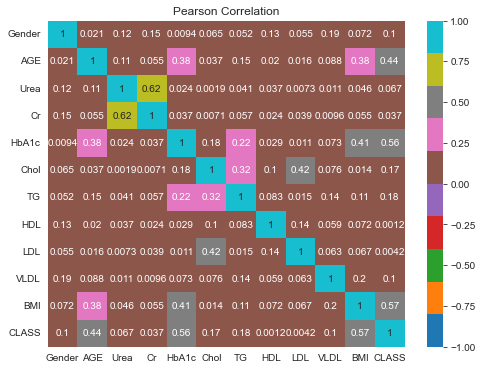

HDL       0.001248
LDL       0.004247
Cr        0.037500
Urea      0.067010
VLDL      0.101247
Gender    0.103397
Chol      0.167375
TG        0.182299
AGE       0.443009
HbA1c     0.555321
BMI       0.569879
CLASS     1.000000
Name: CLASS, dtype: float64


In [87]:
corr = data_new.corr(method='pearson').abs()

corr.describe()
corr.head()

fig = plt.figure(figsize=(8,6))
sns.heatmap(corr, annot=True, cmap='tab10', vmin=-1, vmax=+1)
plt.title('Pearson Correlation')
plt.show()

print (data_new.corr()['CLASS'].abs().sort_values())


### 6.2 Univariate Selection using SelectKBest

In [88]:
X = data_new.iloc[:,0:20]  #independent columns
y = data_new.iloc[:,-1]    #target column

#apply SelectKBest class to extract top 10 best features
bestfeatures = SelectKBest(score_func=chi2, k=10)
fit = bestfeatures.fit(X,y)
dfscores = pd.DataFrame(fit.scores_)
dfcolumns = pd.DataFrame(X.columns)

#concat two dataframes for better visualization
featureScores = pd.concat([dfcolumns,dfscores],axis=1)
featureScores.columns = ['Specs','Score']  #naming the dataframe columns
print(featureScores.nlargest(13,'Score'))  #print 10 best features

     Specs       Score
1      AGE  319.999268
10     BMI  281.183581
4    HbA1c  241.741439
11   CLASS  228.557725
9     VLDL   80.330250
3       Cr   73.363497
6       TG   27.893108
0   Gender   10.283893
5     Chol    9.761831
2     Urea    9.272571
7      HDL    0.309676
8      LDL    0.294061


### 6.3 Feature Importance

[0.00652522 0.03778382 0.00418017 0.00387912 0.10029951 0.01219763
 0.0121594  0.00367165 0.00492343 0.00711799 0.07389604 0.73336602]


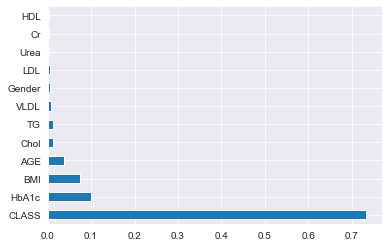

In [89]:
X = data_new.iloc[:,0:20]  #independent columns
y = data_new.iloc[:,-1]    #target column

model = ExtraTreesClassifier()
model.fit(X,y)
print(model.feature_importances_) #use inbuilt class feature_importances of tree based classifiers

#plot graph of feature importances for better visualization
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.nlargest(13).plot(kind='barh')
plt.show()

### 6.4 Correlation Matrix with Heatmap

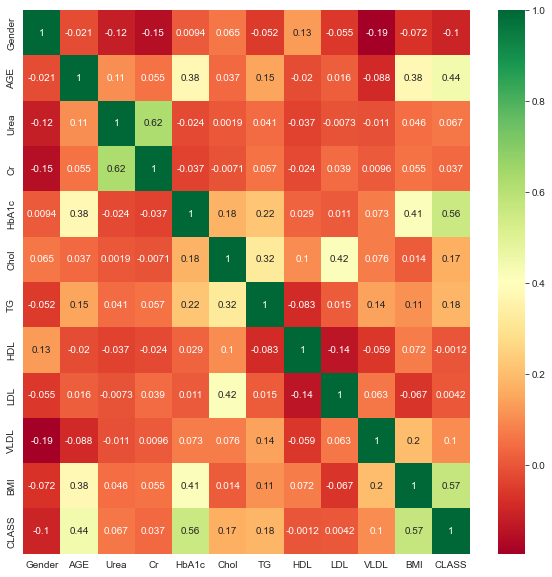

In [90]:
X = data_new.iloc[:,0:20]  #independent columns
y = data_new.iloc[:,-1]    #target column

#get correlations of each features in dataset
corrmat = data_new.corr()
top_corr_features = corrmat.index
plt.figure(figsize=(10,10))

#plot heat map
g=sns.heatmap(data_new[top_corr_features].corr(),annot=True,cmap="RdYlGn")

# 7. Applying Different Models On Train & Test Data #only suggestion feel free to try out other models :)

### 7.1) Model 1 - GBM (Gradient Boosting)


Alicia comment:
- should the diabetes data varialble be the same patterns over all? (yes)
- X and Y variable should be the same/small or big capital everywhere? (X big, and y small)
- how we choose to present the result? should be the same everywhere? (yes, we should ifx it everywhere?, train test split on the top)
- how we plotting the result should be the same with all the models? (plotting in all models)
- should all of the importing library be on the top or should it be where the model training take place? (the best thing is to move everything up.. otherwise put in down)


#### 7.1.1) LightGBM

In [91]:
import  lightgbm as lgb
from sklearn.model_selection import train_test_split
from sklearn import metrics

c:\languages\python\python390\lib\site-packages\lightgbm\sklearn.py:736: UserWarning: 'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose' argument is deprecated and will be removed in a future release of LightGBM. "


[30]	training's multi_logloss: 0.072109	valid_0's multi_logloss: 0.225409
[60]	training's multi_logloss: 0.0196772	valid_0's multi_logloss: 0.225203
[90]	training's multi_logloss: 0.00591342	valid_0's multi_logloss: 0.240197
Training accuracy 1.000000
Testing accuracy 0.928889
              precision    recall  f1-score   support

           0       0.87      0.81      0.84        91
           1       0.47      0.29      0.35        49
           2       0.95      0.98      0.97       760

    accuracy                           0.93       900
   macro avg       0.76      0.69      0.72       900
weighted avg       0.92      0.93      0.92       900



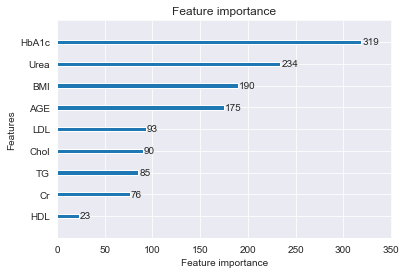

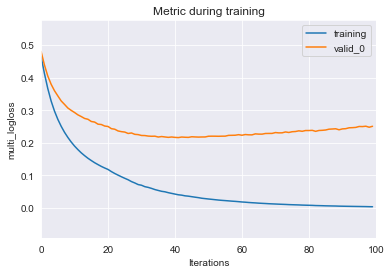

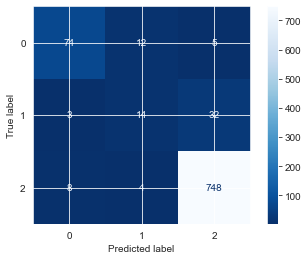

In [92]:
diabetes_gbm = data_new
diabetes_gbm.shape

# define input and output features to train model
X = diabetes_gbm.drop(['CLASS','Gender','VLDL'],axis=1)
y = diabetes_gbm.CLASS

# train and test splitting
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.90,random_state=42)
model = lgb.LGBMClassifier(learning_rate=0.08,max_depth=-3,random_state=42)
model.fit(X_train,y_train,eval_set=[(X_test,y_test),(X_train,y_train)],
          verbose=30,eval_metric='logloss')
print("Training accuracy {:4f}".format(model.score(X_train,y_train)))
print("Testing accuracy {:4f}".format(model.score(X_test,y_test)))

lgb.plot_importance(model)
lgb.plot_metric(model)
metrics.plot_confusion_matrix(model,X_test,y_test,cmap='Blues_r')
print(metrics.classification_report(y_test,model.predict(X_test)))

In [93]:
#another way of doing lightGBM
from sklearn.model_selection import train_test_split
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, precision_score, f1_score, recall_score

diabetes = data_new
diabetes.head()

X,y = diabetes.drop('CLASS',axis=1),diabetes.CLASS

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.75, random_state=42, stratify=y)

preprocessor = make_pipeline(MinMaxScaler())
LightGBMPipeline = make_pipeline(preprocessor,LGBMClassifier(learning_rate=0.08,max_depth=-3,random_state=42))

LightGBMPipeline.fit(X_train, y_train)

y_proba = LightGBMPipeline.predict_proba(X_test)
y_pred = np.argmax(y_proba,axis=1)

print("the f1 score for Random Forest Classifier is :",(f1_score(y_test, y_pred, average="macro")))
print("the precision score is :",(precision_score(y_test, y_pred, average="macro")))
print("the recall score is :",(recall_score(y_test, y_pred, average="macro")))
print("LightGBM Accuracy: %.3f" % metrics.accuracy_score(y_test, y_pred))

the f1 score for Random Forest Classifier is : 0.9454645344936486
the precision score is : 0.9627303359697725
the recall score is : 0.9294016673163593
LightGBM Accuracy: 0.977


#### 7.1.2)  GBM

In [109]:
import sklearn
import pandas as pd
import numpy as np 

from sklearn.metrics import classification_report
from sklearn.model_selection import KFold
from sklearn.ensemble import GradientBoostingClassifier

#new version of the dataset. 
diabetes_sklearn = data_new
diabetes_sklearn.head()

X,y = diabetes_sklearn.drop('CLASS',axis=1),diabetes_sklearn.CLASS

kf = KFold(n_splits=5,random_state=42,shuffle=True)

for train_index,val_index in kf.split(X):
    X_train,X_val = X.iloc[train_index],X.iloc[val_index]
    y_train,y_val = y.iloc[train_index],y.iloc[val_index]
    
gradient_booster = GradientBoostingClassifier(learning_rate=0.1)
gradient_booster.get_params()

gradient_booster.fit(X_train,y_train)
print(classification_report(y_val,gradient_booster.predict(X_val)))

              precision    recall  f1-score   support

           0       0.92      0.96      0.94        25
           1       1.00      1.00      1.00         7
           2       0.99      0.99      0.99       168

    accuracy                           0.98       200
   macro avg       0.97      0.98      0.98       200
weighted avg       0.99      0.98      0.99       200



In [95]:
#another way of doing GBM
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, precision_score, f1_score, recall_score

diabetes = data_new
diabetes.head()

X,y = diabetes.drop('CLASS',axis=1),diabetes.CLASS

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.75, random_state=42, stratify=y)

preprocessor = make_pipeline(MinMaxScaler())
GBMPipline = make_pipeline(preprocessor,GradientBoostingClassifier(learning_rate=0.1))

GBMPipline.fit(X_train, y_train)

y_proba = GBMPipline.predict_proba(X_test)
y_pred = np.argmax(y_proba,axis=1)

print("the f1 score for Random Forest Classifier is :",(f1_score(y_test, y_pred, average="macro")))
print("the precision score is :",(precision_score(y_test, y_pred, average="macro")))
print("the recall score is :",(recall_score(y_test, y_pred, average="macro")))
print("GBM Accuracy %.3f" %metrics.accuracy_score(y_test, y_pred))

the f1 score for Random Forest Classifier is : 0.9524924869692769
the precision score is : 0.9727869831318108
the recall score is : 0.9349066152383688
GBM Accuracy 0.983


#### 7.1.3) XGBoost

In [96]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, precision_score, f1_score, recall_score

diabetes = data_new
diabetes.head()

X,y = diabetes.drop('CLASS',axis=1),diabetes.CLASS

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.80, random_state=42, stratify=y)

preprocessor = make_pipeline(MinMaxScaler())
XGBPipline = make_pipeline(preprocessor,XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bynode=1, colsample_bytree=1, gamma=0, learning_rate=0.1,
       max_delta_step=0, max_depth=3, min_child_weight=1, missing=1,
       n_estimators=100, n_jobs=1, nthread=None,
       objective='multi:softprob', random_state=0, reg_alpha=0,
       reg_lambda=1, scale_pos_weight=None, seed=None, silent=None,
       subsample=1, verbosity=1))

XGBPipline.fit(X_train, y_train)

y_proba = XGBPipline.predict_proba(X_test)
y_pred = np.argmax(y_proba,axis=1)

print("the f1 score for Random Forest Classifier is :",(f1_score(y_test, y_pred, average="macro")))
print("the precision score is :",(precision_score(y_test, y_pred, average="macro")))
print("the recall score is :",(recall_score(y_test, y_pred, average="macro")))
print("XGBoost Accuracy %.3f" %metrics.accuracy_score(y_test, y_pred))

the f1 score for Random Forest Classifier is : 0.9598550255414059
the precision score is : 0.9833995917051682
the recall score is : 0.9398117686603222
XGBoost Accuracy 0.985


#### 7.1.4) CatBoost

In [97]:
from sklearn.model_selection import train_test_split

diabetes = data_new
diabetes.head()

X,y = diabetes.drop('CLASS',axis=1),diabetes.CLASS

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.75, random_state=42, stratify=y)

preprocessor = make_pipeline(MinMaxScaler())
CatPipeline = make_pipeline(preprocessor, CatBoostClassifier(iterations = 1000, loss_function='MultiClass',
                                                             bootstrap_type = "Bayesian",
                                                             eval_metric = 'MultiClass',
                                                             leaf_estimation_iterations = 100,
                                                             random_strength = 0.5,
                                                             depth = 7,
                                                             l2_leaf_reg = 5,
                                                             learning_rate=0.1,
                                                             bagging_temperature = 0.5,
                                                             allow_writing_files=False))
CatPipeline.fit(X_train, y_train)
y_proba = CatPipeline.predict_proba(X_test)
y_pred = np.argmax(y_proba,axis=1)

print("the f1 score for Random Forest Classifier is :",(f1_score(y_test, y_pred, average="macro")))
print("the precision score is :",(precision_score(y_test, y_pred, average="macro")))
print("the recall score is :",(recall_score(y_test, y_pred, average="macro")))
print("CatBoost Accuracy %.3f" %metrics.accuracy_score(y_test, y_pred))

0:	learn: 0.7749422	total: 236ms	remaining: 3m 55s
1:	learn: 0.4996760	total: 272ms	remaining: 2m 15s
2:	learn: 0.3461693	total: 311ms	remaining: 1m 43s
3:	learn: 0.2463637	total: 346ms	remaining: 1m 26s
4:	learn: 0.1774079	total: 367ms	remaining: 1m 13s
5:	learn: 0.1353639	total: 407ms	remaining: 1m 7s
6:	learn: 0.1009567	total: 442ms	remaining: 1m 2s
7:	learn: 0.0766700	total: 504ms	remaining: 1m 2s
8:	learn: 0.0590087	total: 548ms	remaining: 1m
9:	learn: 0.0465521	total: 594ms	remaining: 58.8s
10:	learn: 0.0377937	total: 659ms	remaining: 59.3s
11:	learn: 0.0322825	total: 700ms	remaining: 57.6s
12:	learn: 0.0270211	total: 745ms	remaining: 56.6s
13:	learn: 0.0234827	total: 841ms	remaining: 59.2s
14:	learn: 0.0202445	total: 1.22s	remaining: 1m 19s
15:	learn: 0.0180700	total: 1.3s	remaining: 1m 19s
16:	learn: 0.0158127	total: 1.37s	remaining: 1m 19s
17:	learn: 0.0134566	total: 1.44s	remaining: 1m 18s
18:	learn: 0.0119131	total: 1.49s	remaining: 1m 16s
19:	learn: 0.0106588	total: 1.56s	r

#### 7.1.5) AdaBoost

In [98]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, precision_score, f1_score, recall_score


diabetes = data_new
diabetes.head()

X,y = diabetes.drop('CLASS',axis=1),diabetes.CLASS

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.75, random_state=42, stratify=y)

preprocessor = make_pipeline(MinMaxScaler())
AdaPipeline = make_pipeline(preprocessor,AdaBoostClassifier(n_estimators=200, learning_rate=1.4))

AdaPipeline.fit(X_train, y_train)
y_proba = AdaPipeline.predict_proba(X_test)
y_pred = np.argmax(y_proba,axis=1)

print("the f1 score for Random Forest Classifier is :",(f1_score(y_test, y_pred, average="macro")))
print("the precision score is :",(precision_score(y_test, y_pred, average="macro")))
print("the recall score is :",(recall_score(y_test, y_pred, average="macro")))
print("Adaboost Accuracy %.3f" %metrics.accuracy_score(y_test, y_pred))

the f1 score for Random Forest Classifier is : 0.8827636691282305
the precision score is : 0.9193636975872183
the recall score is : 0.8519706202170657
Adaboost Accuracy 0.959


### 7.2) Model 2 - Logistic Regression


In [111]:
# Importing basic packages
#
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
 
# Importing Sklearn module and classes
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.model_selection import train_test_split

LG_diabetes = data_new
LG_diabetes.head()

X,y = LG_diabetes.drop('CLASS',axis=1),LG_diabetes.CLASS

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.75, random_state=42, stratify=y)

sc = StandardScaler()
sc.fit(X_train)
X_train_std = sc.transform(X_train)
X_test_std = sc.transform(X_test)

# Create an instance of LogisticRegression classifier
lr = LogisticRegression(C=100.0, random_state=1, solver='lbfgs', multi_class='ovr')
 
# Fit the model
#
lr.fit(X_train_std, y_train)

# Create the predictions
#
y_predict = lr.predict(X_test_std)
 
# Use metrics.accuracy_score to measure the score
print("LogisticRegression Accuracy %.3f" %metrics.accuracy_score(y_test, y_predict))

LogisticRegression Accuracy 0.921


### 7.3) Model 3 - Random Forest Classifier

a) Define model parameters to be tuned
b) Using GridSearch Cross Validation to find out the best parameters using L2 penalty
c) Displaying the best parameters
d) Refitting the model with the best parameters
e) Displaying model prediction and classification report
f) Saving the variables used in the model
g) Saving the best model
h) Model Evaluation
i) Making predictions for test data
j) Evaluating prediction accuracy for test data



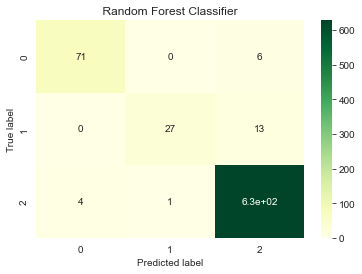

the f1 score for Random Forest Classifier is : 0.9031927244582043
the precision score is : 0.9605286916415201
the recall score is : 0.8630596759743678
Random Forest Accuracy 0.968


In [112]:
from sklearn.metrics import confusion_matrix, precision_score, f1_score, recall_score
from sklearn.ensemble import RandomForestClassifier

rf = RandomForestClassifier()
rf.fit(X_train,y_train)

predictions = rf.predict(X_test)

sns.heatmap(confusion_matrix(y_test, predictions), annot=True, cmap="YlGn")
plt.title(' Random Forest Classifier ')
plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()

print("the f1 score for Random Forest Classifier is :",(f1_score(y_test, predictions, average="macro")))
print("the precision score is :",(precision_score(y_test, predictions, average="macro")))
print("the recall score is :",(recall_score(y_test, predictions, average="macro")))
print("Random Forest Accuracy %.3f" %metrics.accuracy_score(y_test, predictions))


## 7.4 KNN

[[ 25  44  22]
 [  4   8  22]
 [  6  25 594]]
              precision    recall  f1-score   support

           0       0.71      0.27      0.40        91
           1       0.10      0.24      0.14        34
           2       0.93      0.95      0.94       625

    accuracy                           0.84       750
   macro avg       0.58      0.49      0.49       750
weighted avg       0.87      0.84      0.84       750



Text(0, 0.5, 'Mean Error')

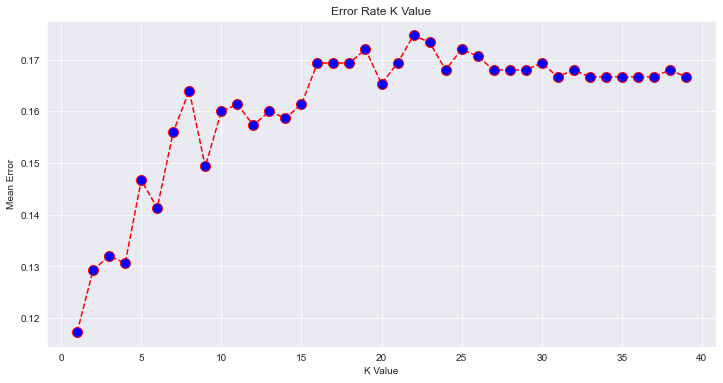

In [101]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

KNN_diabetes = data_new
KNN_diabetes.head()

X,y = KNN_diabetes.drop('CLASS',axis=1),KNN_diabetes.CLASS

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.75)

from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(X_train)

X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

from sklearn.neighbors import KNeighborsClassifier
classifier = KNeighborsClassifier(n_neighbors=8)
classifier.fit(X_train, y_train)

y_pred = classifier.predict(X_test)

from sklearn.metrics import classification_report, confusion_matrix
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

error = []

# Calculating error for K values between 1 and 40
for i in range(1, 40):
    knn = KNeighborsClassifier(n_neighbors=i)
    knn.fit(X_train, y_train)
    pred_i = knn.predict(X_test)
    error.append(np.mean(pred_i != y_test))
    
plt.figure(figsize=(12, 6))
plt.plot(range(1, 40), error, color='red', linestyle='dashed', marker='o',
         markerfacecolor='blue', markersize=10)
plt.title('Error Rate K Value')
plt.xlabel('K Value')
plt.ylabel('Mean Error')

## 7.5 Support Vector Machine

In [102]:
#multiclass problem for support vector machine https://scikit-learn.org/stable/modules/svm.html

from sklearn.metrics import roc_auc_score, accuracy_score
from sklearn.svm import SVC
from sklearn.svm import LinearSVC

diabetes_svm = data_new
diabetes_svm.head()

# define input and output features to train model
X = diabetes_svm.drop(['CLASS','Gender','VLDL'],axis=1)
y = diabetes_svm['CLASS']

# train and test splitting
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.90,random_state=42)

In [103]:
#this model does not work yet .. still working on

#lin_clf = LinearSVC()
#lin_clf.fit(X, y)
#lin_clf_prediction = lin_clf.decision_function(X_test)
#print(lin_clf_prediction)

#print("the f1 score for Support Vector machine is :",(f1_score(y_test, lin_clf_prediction , average="macro")))
#print("the precision score is :",(precision_score(y_test, lin_clf_prediction , average="macro")))
#print("the recall score is :",(recall_score(y_test, lin_clf_prediction , average="macro")))
#print("Support Vector machine %.3f" %metrics.accuracy_score(y_test, lin_clf_prediction ))

In [104]:
#another way of doing support vector machine
SVM = SVC(random_state=0,probability=True,C=80.0,gamma=0.00002,kernel='rbf')
SVM.fit(X_train,y_train)
predictions3 = SVM.predict(X_test)
probabilities2 = SVM.predict_proba(X_test)

print("the f1 score for Support Vector machine is :",(f1_score(y_test, predictions3, average="macro")))
print("the precision score is :",(precision_score(y_test, predictions3, average="macro")))
print("the recall score is :",(recall_score(y_test, predictions3, average="macro")))
print("Support Vector machine acuracy %.3f" %metrics.accuracy_score(y_test, predictions3))

the f1 score for Support Vector machine is : 0.3436717047006576
the precision score is : 0.3485897566439263
the recall score is : 0.35138808559861195
Support Vector machine acuracy 0.817


c:\languages\python\python390\lib\site-packages\sklearn\metrics\_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


## Decision tree

Text(0.5, 1.0, 'Total Impurity vs effective alpha for training set')

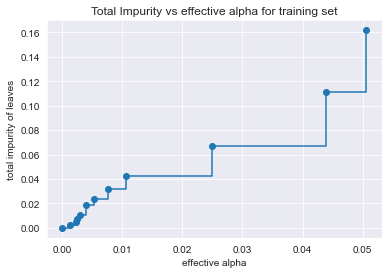

In [105]:
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier

decision_diabetes = data_new
X, y = decision_diabetes.drop('CLASS',axis=1), decision_diabetes.CLASS

X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)

clf = DecisionTreeClassifier(random_state=42)
path = clf.cost_complexity_pruning_path(X_train, y_train)
ccp_alphas, impurities = path.ccp_alphas, path.impurities

fig, ax = plt.subplots()
ax.plot(ccp_alphas[:-1], impurities[:-1], marker="o", drawstyle="steps-post")
ax.set_xlabel("effective alpha")
ax.set_ylabel("total impurity of leaves")
ax.set_title("Total Impurity vs effective alpha for training set")

## Naive Bayes

In [106]:
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB

naive_diabetes = data_new

X, y = naive_diabetes.drop('CLASS',axis=1),naive_diabetes.CLASS
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.75, random_state=42)
gnb = GaussianNB()

y_pred = gnb.fit(X_train, y_train).predict(X_test)
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred).sum()))

Number of mislabeled points out of a total 750 points : 67


## Removed methods because they were unsupervised and not that great to use for dataset. 
##### Linear regression model has issues. It would be better to not use it due to that. 
##### K-means is harder to track if it's predicting correctly. So not as good to use for classification problem 
##### Dimensionality reduction algorithm we didn't implement as we already had multiple things that we could use 

#### Supervised learning
Decision trees * Ensembles (Bagging Boosting Random forest) * k-NN * Linear regression * Naive Bayes * Artificial neural networks * Logistic regression * Relevance vector machine (RVM) * Support vector machine (SVM)

# 8. Displaying Best Model?

In [107]:
#from sklearn.metrics import roc_curve
